#**LEVEL 1**

---



# Dataset Loading and Exploring

In [2]:
# Import necessary libraries
import pandas as pd
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, MultiLabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns
from imblearn.over_sampling import SMOTENC
from sklearn.preprocessing import KBinsDiscretizer

In [ ]:
# Loading the dataset
df = pd.read_csv('/dataset.csv')

In [4]:
#Display the first 20 rows of dataset
display(df.head(20))

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenu...","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Mak...",121.027535,14.565443,"French, Japanese, Desserts",...,Botswana Pula(P),Yes,No,No,No,3,4.8,Dark Green,Excellent,314
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi...","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Ma...",121.014101,14.553708,Japanese,...,Botswana Pula(P),Yes,No,No,No,3,4.5,Dark Green,Excellent,591
2,6300002,Heat - Edsa Shangri-La,162,Mandaluyong City,"Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...","Edsa Shangri-La, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City, Ma...",121.056831,14.581404,"Seafood, Asian, Filipino, Indian",...,Botswana Pula(P),Yes,No,No,No,4,4.4,Green,Very Good,270
3,6318506,Ooma,162,Mandaluyong City,"Third Floor, Mega Fashion Hall, SM Megamall, O...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.056475,14.585318,"Japanese, Sushi",...,Botswana Pula(P),No,No,No,No,4,4.9,Dark Green,Excellent,365
4,6314302,Sambo Kojin,162,Mandaluyong City,"Third Floor, Mega Atrium, SM Megamall, Ortigas...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.057508,14.584450,"Japanese, Korean",...,Botswana Pula(P),Yes,No,No,No,4,4.8,Dark Green,Excellent,229
5,18189371,Din Tai Fung,162,Mandaluyong City,"Ground Floor, Mega Fashion Hall, SM Megamall, ...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.056314,14.583764,Chinese,...,Botswana Pula(P),No,No,No,No,3,4.4,Green,Very Good,336
6,6300781,Buffet 101,162,Pasay City,"Building K, SM By The Bay, Sunset Boulevard, M...","SM by the Bay, Mall of Asia Complex, Pasay City","SM by the Bay, Mall of Asia Complex, Pasay Cit...",120.979667,14.531333,"Asian, European",...,Botswana Pula(P),Yes,No,No,No,4,4.0,Green,Very Good,520
7,6301290,Vikings,162,Pasay City,"Building B, By The Bay, Seaside Boulevard, Mal...","SM by the Bay, Mall of Asia Complex, Pasay City","SM by the Bay, Mall of Asia Complex, Pasay Cit...",120.979333,14.540000,"Seafood, Filipino, Asian, European",...,Botswana Pula(P),Yes,No,No,No,4,4.2,Green,Very Good,677
8,6300010,Spiral - Sofitel Philippine Plaza Manila,162,Pasay City,"Plaza Level, Sofitel Philippine Plaza Manila, ...","Sofitel Philippine Plaza Manila, Pasay City","Sofitel Philippine Plaza Manila, Pasay City, P...",120.980090,14.552990,"European, Asian, Indian",...,Botswana Pula(P),Yes,No,No,No,4,4.9,Dark Green,Excellent,621
9,6314987,Locavore,162,Pasig City,"Brixton Technology Center, 10 Brixton Street, ...",Kapitolyo,"Kapitolyo, Pasig City",121.056532,14.572041,Filipino,...,Botswana Pula(P),Yes,No,No,No,3,4.8,Dark Green,Excellent,532


In [5]:
# Get the number of rows and columns
row_n, col_n = df.shape
print(f'Number of rows: {row_n}')
print(f'Number of columns: {col_n}')

Number of rows: 9551
Number of columns: 21


# Doing type conversion - I

In [6]:
# Check data types of each column
print(df.dtypes)

Restaurant ID             int64
Restaurant Name          object
Country Code              int64
City                     object
Address                  object
Locality                 object
Locality Verbose         object
Longitude               float64
Latitude                float64
Cuisines                 object
Average Cost for two      int64
Currency                 object
Has Table booking        object
Has Online delivery      object
Is delivering now        object
Switch to order menu     object
Price range               int64
Aggregate rating        float64
Rating color             object
Rating text              object
Votes                     int64
dtype: object


Columns that need type conversion:

1. ***Has Table booking, Has Online delivery, Is delivering now, Switch to order menu***: These columns represent binary categories (Yes/No or True/False). Using ordinal encoder.
2. ***Currency, Rating color, Rating text***: These are categorical variables and should be converted to numerical representations. Using one-hot encoding.
3. ***Cuisines***: This column contain multiple cuisines separated by commas. Converting it into a list of cuisines and using multi-label encoding.

In [7]:
# Define categorical columns for ordinal and one-hot encoding
categorical_cols1 = ['Has Table booking', 'Has Online delivery', 'Is delivering now', 'Switch to order menu'] # Binary features
categorical_cols2 = ['Rating color', 'Rating text', 'Currency'] # Nominal features

# Initialize encoders
encoder1 = OrdinalEncoder() # For ordinal features
encoder2 = OneHotEncoder(sparse_output=False) # For nominal features

# Apply ordinal encoding
df[categorical_cols1] = encoder1.fit_transform(df[categorical_cols1])

# Apply one-hot encoding and concatenate with original DataFrame
encoded = encoder2.fit_transform(df[categorical_cols2])
df = pd.concat([df, pd.DataFrame(encoded, columns=encoder2.get_feature_names_out(categorical_cols2))], axis=1)
df.drop(columns=categorical_cols2, inplace=True) # Remove original nominal columns

In [8]:
print(df.head())
print(df.shape)

   Restaurant ID         Restaurant Name  Country Code              City  \
0        6317637        Le Petit Souffle           162       Makati City   
1        6304287        Izakaya Kikufuji           162       Makati City   
2        6300002  Heat - Edsa Shangri-La           162  Mandaluyong City   
3        6318506                    Ooma           162  Mandaluyong City   
4        6314302             Sambo Kojin           162  Mandaluyong City   

                                             Address  \
0  Third Floor, Century City Mall, Kalayaan Avenu...   
1  Little Tokyo, 2277 Chino Roces Avenue, Legaspi...   
2  Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...   
3  Third Floor, Mega Fashion Hall, SM Megamall, O...   
4  Third Floor, Mega Atrium, SM Megamall, Ortigas...   

                                     Locality  \
0   Century City Mall, Poblacion, Makati City   
1  Little Tokyo, Legaspi Village, Makati City   
2  Edsa Shangri-La, Ortigas, Mandaluyong City   
3      SM 

#Check for missing values in each column

In [9]:
# Check for missing values in each column
missing_n = df.isnull().sum()
print(missing_n)

Restaurant ID                      0
Restaurant Name                    0
Country Code                       0
City                               0
Address                            0
Locality                           0
Locality Verbose                   0
Longitude                          0
Latitude                           0
Cuisines                           9
Average Cost for two               0
Has Table booking                  0
Has Online delivery                0
Is delivering now                  0
Switch to order menu               0
Price range                        0
Aggregate rating                   0
Votes                              0
Rating color_Dark Green            0
Rating color_Green                 0
Rating color_Orange                0
Rating color_Red                   0
Rating color_White                 0
Rating color_Yellow                0
Rating text_Average                0
Rating text_Excellent              0
Rating text_Good                   0
R

In [10]:
# Display rows with any missing values
null_rows = df[df.isnull().any(axis=1)]
print(null_rows)

     Restaurant ID                 Restaurant Name  Country Code  \
84        17284105                   Cookie Shoppe           216   
87        17284211  Pearly's Famous Country Cookng           216   
94        17284158               Jimmie's Hot Dogs           216   
297       17374552                  Corkscrew Cafe           216   
328       17501439                        Dovetail           216   
346       17606621            HI Lite Bar & Lounge           216   
368       17059060                       Hillstone           216   
418       17142698                Leonard's Bakery           216   
455       17616465        Tybee Island Social Club           216   

               City                                          Address  \
84           Albany               115 N Jackson St, Albany, GA 31701   
87           Albany             814 N Slappey Blvd, Albany, GA 31701   
94           Albany               204 S Jackson St, Albany, GA 31701   
297     Gainesville            

As 9 cuisines are missing we will just drop these 9 rows




In [11]:
# Drop rows with missing values in 'Cuisines' column
df.dropna(axis=0, inplace=True)

Upadated number of rows and columns

In [12]:
row_n, col_n = df.shape
print(f'Number of rows: {row_n}')
print(f'Number of columns: {col_n}')

Number of rows: 9542
Number of columns: 42


# Doing Type Conversion - II (Cuisines)

In [13]:
# Convert 'Cuisines' column to a list of cuisines
df['Cuisines'] = df['Cuisines'].str.split(',')

# Explode the 'Cuisines' column for multi-label encoding
Cuisines = df['Cuisines'].explode()

# Apply multi-label encoding
mlb = MultiLabelBinarizer()
mlb.fit(df['Cuisines'])
cuisine_encoded = mlb.transform(df['Cuisines'])

# Create a DataFrame for encoded cuisines and concatenate
cuisine_df = pd.DataFrame(cuisine_encoded, columns=['Cuisine_' + c for c in mlb.classes_], index=df.index)
df = pd.concat([df, cuisine_df], axis=1)
df.drop(columns=['Cuisines'], inplace=True) # Remove original 'Cuisines' column

In [14]:
print(df.head())
print(df.shape)

   Restaurant ID         Restaurant Name  Country Code              City  \
0        6317637        Le Petit Souffle           162       Makati City   
1        6304287        Izakaya Kikufuji           162       Makati City   
2        6300002  Heat - Edsa Shangri-La           162  Mandaluyong City   
3        6318506                    Ooma           162  Mandaluyong City   
4        6314302             Sambo Kojin           162  Mandaluyong City   

                                             Address  \
0  Third Floor, Century City Mall, Kalayaan Avenu...   
1  Little Tokyo, 2277 Chino Roces Avenue, Legaspi...   
2  Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...   
3  Third Floor, Mega Fashion Hall, SM Megamall, O...   
4  Third Floor, Mega Atrium, SM Megamall, Ortigas...   

                                     Locality  \
0   Century City Mall, Poblacion, Makati City   
1  Little Tokyo, Legaspi Village, Makati City   
2  Edsa Shangri-La, Ortigas, Mandaluyong City   
3      SM 

#Check for missing values in each column

In [15]:
missing_n = df.isnull().sum()
print(missing_n)

Restaurant ID            0
Restaurant Name          0
Country Code             0
City                     0
Address                  0
                        ..
Cuisine_Turkish          0
Cuisine_Turkish Pizza    0
Cuisine_Vietnamese       0
Cuisine_Western          0
Cuisine_World Cuisine    0
Length: 290, dtype: int64


In [16]:
null_rows = df[df.isnull().any(axis=1)]
print(null_rows)

Empty DataFrame
Columns: [Restaurant ID, Restaurant Name, Country Code, City, Address, Locality, Locality Verbose, Longitude, Latitude, Average Cost for two, Has Table booking, Has Online delivery, Is delivering now, Switch to order menu, Price range, Aggregate rating, Votes, Rating color_Dark Green, Rating color_Green, Rating color_Orange, Rating color_Red, Rating color_White, Rating color_Yellow, Rating text_Average, Rating text_Excellent, Rating text_Good, Rating text_Not rated, Rating text_Poor, Rating text_Very Good, Currency_Botswana Pula(P), Currency_Brazilian Real(R$), Currency_Dollar($), Currency_Emirati Diram(AED), Currency_Indian Rupees(Rs.), Currency_Indonesian Rupiah(IDR), Currency_NewZealand($), Currency_Pounds(��), Currency_Qatari Rial(QR), Currency_Rand(R), Currency_Sri Lankan Rupee(LKR), Currency_Turkish Lira(TL), Cuisine_ Afghani, Cuisine_ African, Cuisine_ American, Cuisine_ Andhra, Cuisine_ Arabian, Cuisine_ Argentine, Cuisine_ Armenian, Cuisine_ Asian, Cuisine_ Ass

As 9 cuisines are missing we will just drop these 9 rows




In [17]:
df.dropna(axis = 0,inplace=True)

Upadated number of rows and columns

In [18]:
row_n, col_n = df.shape
print(f'Number of rows: {row_n}')
print(f'Number of columns: {col_n}')

Number of rows: 9542
Number of columns: 290



#Class Imabalce


In [19]:
# Check class distribution of 'Aggregate rating'
class_n = df['Aggregate rating'].value_counts()
print(class_n)
class_proportions = class_n / len(df)
print(class_proportions)

Aggregate rating
0.0    2148
3.2     522
3.1     519
3.4     495
3.3     483
3.5     480
3.0     468
3.6     458
3.7     427
3.8     399
2.9     381
3.9     332
2.8     315
4.1     274
4.0     266
2.7     250
4.2     221
2.6     191
4.3     174
4.4     143
2.5     110
4.5      95
2.4      87
4.6      78
4.9      61
2.3      47
4.7      41
2.2      27
4.8      25
2.1      15
2.0       7
1.9       2
1.8       1
Name: count, dtype: int64
Aggregate rating
0.0    0.225110
3.2    0.054706
3.1    0.054391
3.4    0.051876
3.3    0.050618
3.5    0.050304
3.0    0.049046
3.6    0.047998
3.7    0.044750
3.8    0.041815
2.9    0.039929
3.9    0.034794
2.8    0.033012
4.1    0.028715
4.0    0.027877
2.7    0.026200
4.2    0.023161
2.6    0.020017
4.3    0.018235
4.4    0.014986
2.5    0.011528
4.5    0.009956
2.4    0.009118
4.6    0.008174
4.9    0.006393
2.3    0.004926
4.7    0.004297
2.2    0.002830
4.8    0.002620
2.1    0.001572
2.0    0.000734
1.9    0.000210
1.8    0.000105
Name: count, dty

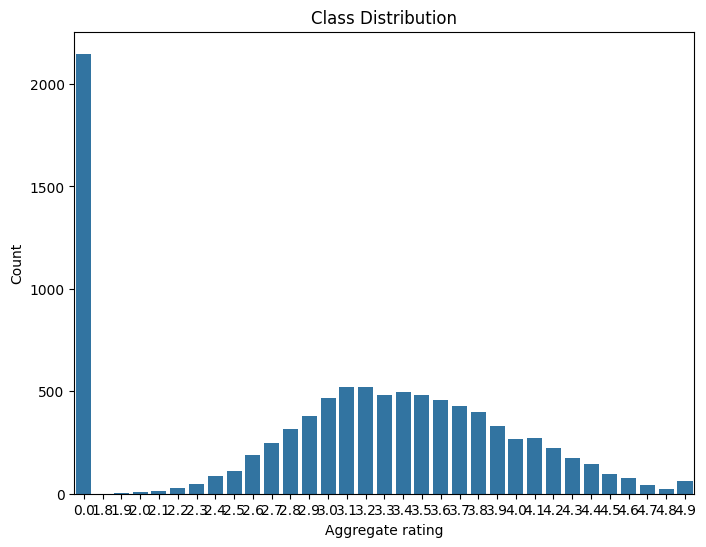

In [20]:
# Visualize class distribution (optional)
plt.figure(figsize=(8, 6))
sns.countplot(data=df, x='Aggregate rating')
plt.xlabel('Aggregate rating')
plt.ylabel('Count')
plt.title('Class Distribution')
plt.show()

In [21]:
# Bin the 'Aggregate rating' into discrete categories
discretizer = KBinsDiscretizer(n_bins=10, encode='ordinal', strategy='uniform')
df['Rating_Category'] = discretizer.fit_transform(df[['Aggregate rating']])

# Separate features and the binned target variable
X = df.drop(columns=['Aggregate rating', 'Rating_Category'])
y = df['Rating_Category']

# Identify categorical feature indices
categorical_features = X.select_dtypes(include=['object']).columns.tolist()
categorical_indices = [X.columns.get_loc(col) for col in categorical_features]

# Initialize SMOTENC with a lower k_neighbors value
smotenc = SMOTENC(categorical_features=categorical_indices, random_state=42, k_neighbors=2)

# Apply SMOTENC
X_resampled, y_resampled = smotenc.fit_resample(X, y)

<ipython-input-22-6a33cbb5e46e>:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  resampled_df['Rating_Category'] = y_resampled


Rating_Category
9.0    2487
8.0    2487
7.0    2487
6.0    2487
0.0    2487
4.0    2487
5.0    2487
3.0    2487
Name: count, dtype: int64
Rating_Category
9.0    0.125
8.0    0.125
7.0    0.125
6.0    0.125
0.0    0.125
4.0    0.125
5.0    0.125
3.0    0.125
Name: count, dtype: float64


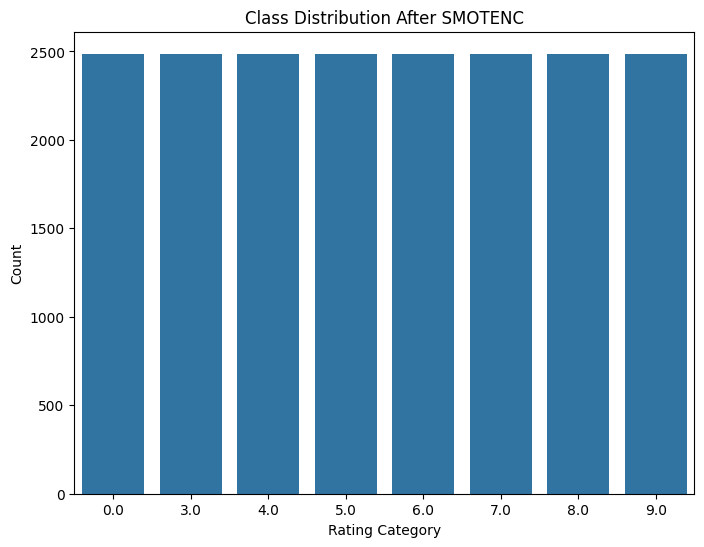

In [22]:
# Create a DataFrame from the resampled data
resampled_df = pd.DataFrame(X_resampled, columns=X.columns)
resampled_df['Rating_Category'] = y_resampled

# Check the class distribution
class_n_resampled = resampled_df['Rating_Category'].value_counts()
print(class_n_resampled)

# Calculate and print class proportions
class_proportions_resampled = class_n_resampled / len(resampled_df)
print(class_proportions_resampled)

# Visualize the class distribution using a countplot
plt.figure(figsize=(8, 6))
sns.countplot(data=resampled_df, x='Rating_Category')
plt.xlabel('Rating Category')
plt.ylabel('Count')
plt.title('Class Distribution After SMOTENC')
plt.show()

#Describing Data


In [23]:
df = resampled_df

# Select numerical columns
selected_cols = ['Average Cost for two', 'Price range', 'Votes', 'Rating_Category']

# Calculate statistics
statistics = df[selected_cols].describe()

# Display the statistics
print(statistics)

       Average Cost for two   Price range         Votes  Rating_Category
count          19896.000000  19896.000000  19896.000000     19896.000000
mean            1825.614948      1.831072    238.537193         5.250000
std            21344.404761      0.860727    545.428324         2.727247
min                0.000000      1.000000      0.000000         0.000000
25%              300.000000      1.000000     17.000000         3.750000
50%              485.000000      2.000000     81.000000         5.500000
75%              741.000000      2.000000    227.000000         7.250000
max           800000.000000      4.000000  10934.000000         9.000000


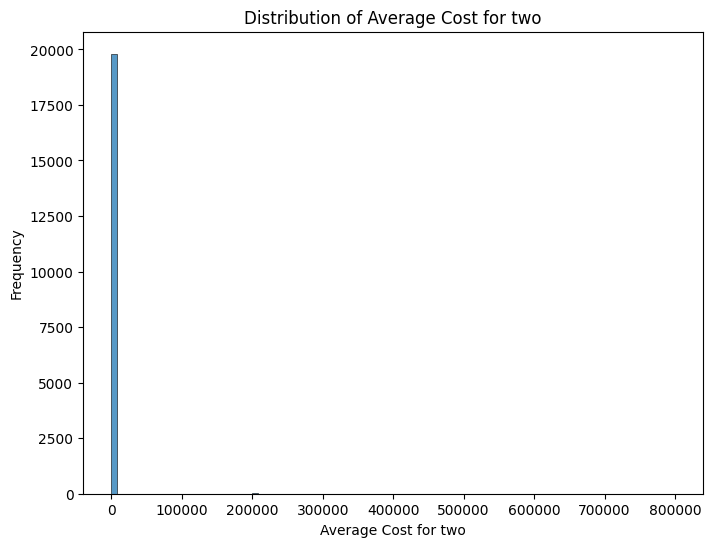

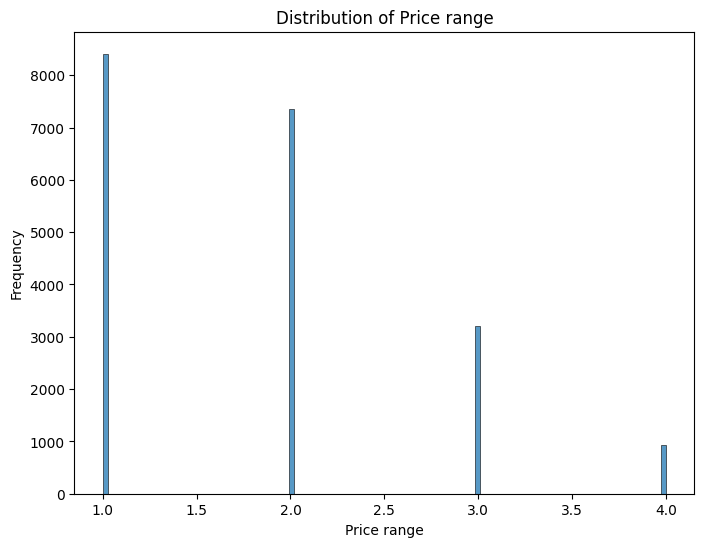

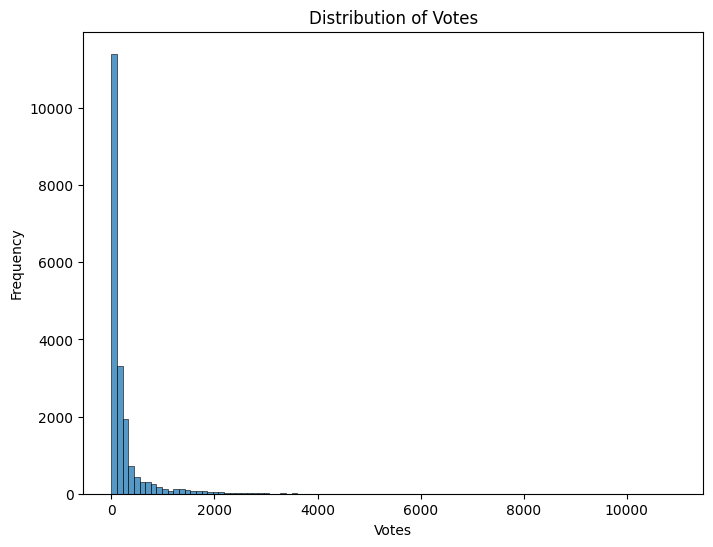

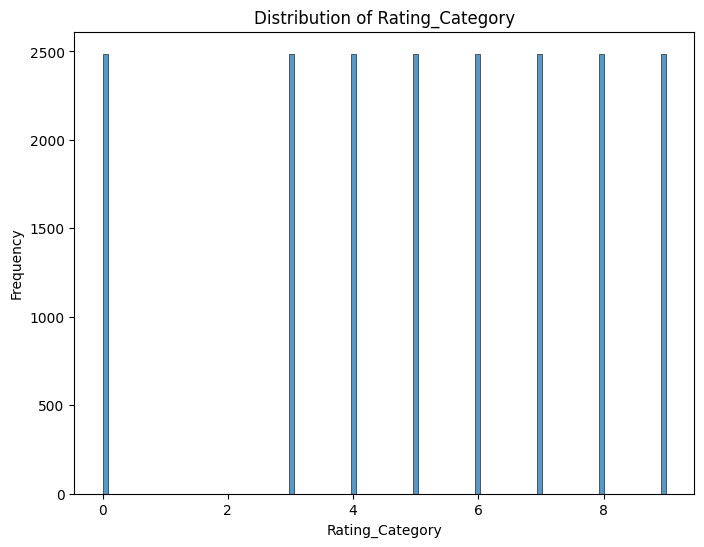

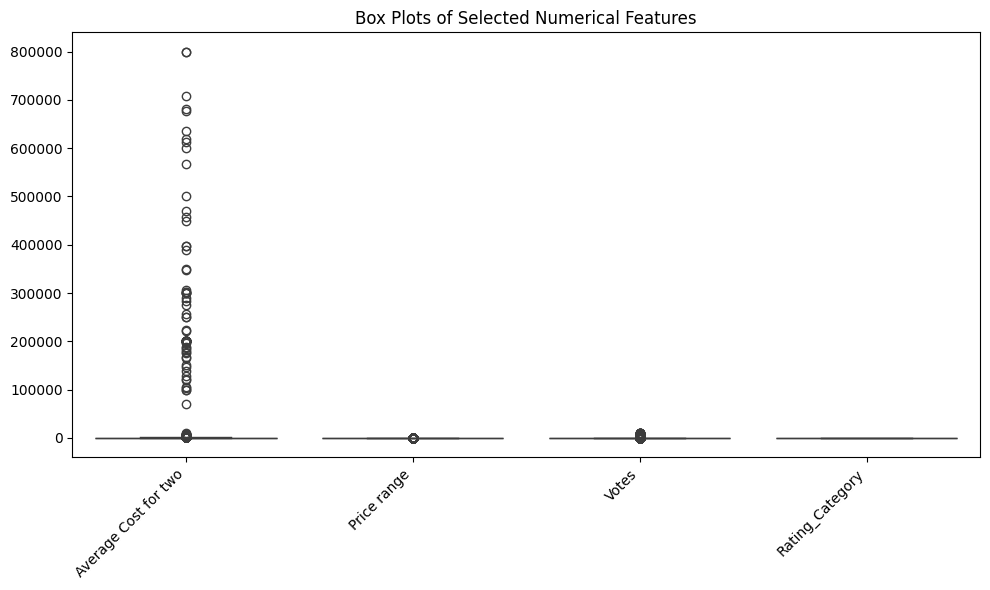

In [24]:
# Histograms for distributions
for col in selected_cols:
    plt.figure(figsize=(8, 6))
    sns.histplot(df[col], bins=100)
    plt.title(f'Distribution of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.show()

# Box plots for comparisons and outliers
plt.figure(figsize=(10, 6))
sns.boxplot(data=df[selected_cols])
plt.title('Box Plots of Selected Numerical Features')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for readability
plt.tight_layout()
plt.show()

#Analysis of categorical values


Top Cuisines:
Cuisines
North Indian    3960
Chinese         2735
Fast Food       1986
Mughlai          995
Italian          764
Bakery           745
Continental      736
Cafe             703
Desserts         653
South Indian     636
Name: count, dtype: int64


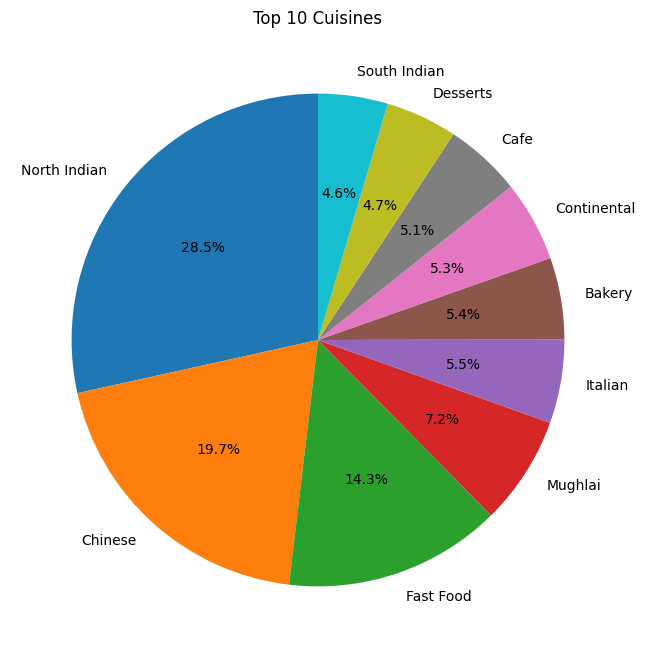

In [25]:
# Top Cuisines
cuisine_counts = Cuisines.str.strip().value_counts()
top_cuisines = cuisine_counts.head(10)  # Get top 10 cuisines
print("\nTop Cuisines:")
print(top_cuisines)

plt.figure(figsize=(8, 8))
plt.pie(top_cuisines.values, labels=top_cuisines.index, autopct='%1.1f%%', startangle=90)
plt.title('Top 10 Cuisines')
plt.show()


Cities with Highest Restaurant Count:
City
New Delhi         10238
Noida              2013
Gurgaon            1920
Ghaziabad           873
Faridabad           360
London              145
Rio de Janeiro      120
Dubai               111
Auckland            106
Abu Dhabi           104
Name: Restaurant ID, dtype: int64


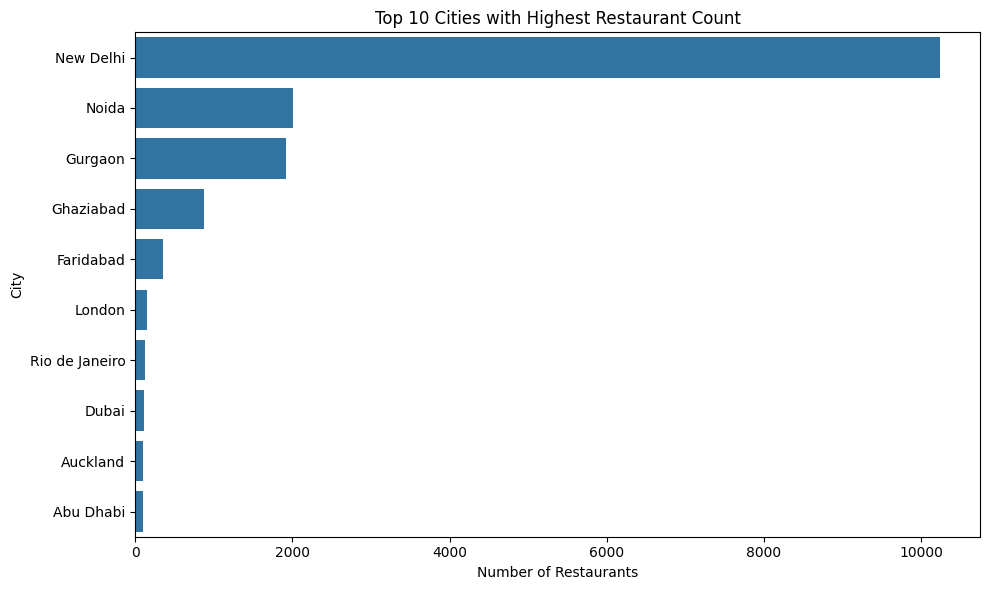

In [26]:
# Cities with Highest Restaurant Count
city_counts = df.groupby('City')['Restaurant ID'].count().sort_values(ascending=False)
top_cities = city_counts.head(10)  # Get top 10 cities
print("\nCities with Highest Restaurant Count:")
print(top_cities)

plt.figure(figsize=(10, 6))
sns.barplot(x=top_cities.values, y=top_cities.index)
plt.title('Top 10 Cities with Highest Restaurant Count')
plt.xlabel('Number of Restaurants')
plt.ylabel('City')
plt.tight_layout()
plt.show()

#Geospatial Analysis

In [27]:
#!pip install folium==0.12.1.post1

In [28]:
import folium

In [29]:
# Center the map on a specific location
map_center = [df['Latitude'].mean(), df['Longitude'].mean()]
restaurant_map = folium.Map(location=map_center, zoom_start=10)

In [30]:
# Add markers for restaurants:
for index, row in df.iterrows():
       folium.Marker(
           location=[row['Latitude'], row['Longitude']],
           popup=row['Restaurant Name'],
           icon=folium.Icon(color='blue', icon='cutlery'),
       ).add_to(restaurant_map)

In [31]:
# Display the map:
restaurant_map

In [32]:
display(df.head(20))

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Average Cost for two,...,Cuisine_Tea,Cuisine_Tex-Mex,Cuisine_Thai,Cuisine_Tibetan,Cuisine_Turkish,Cuisine_Turkish Pizza,Cuisine_Vietnamese,Cuisine_Western,Cuisine_World Cuisine,Rating_Category
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenu...","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Mak...",121.027535,14.565443,1100,...,0,0,0,0,0,0,0,0,0,9.0
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi...","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Ma...",121.014101,14.553708,1200,...,0,0,0,0,0,0,0,0,0,9.0
2,6300002,Heat - Edsa Shangri-La,162,Mandaluyong City,"Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...","Edsa Shangri-La, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City, Ma...",121.056831,14.581404,4000,...,0,0,0,0,0,0,0,0,0,8.0
3,6318506,Ooma,162,Mandaluyong City,"Third Floor, Mega Fashion Hall, SM Megamall, O...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.056475,14.585318,1500,...,0,0,0,0,0,0,0,0,0,9.0
4,6314302,Sambo Kojin,162,Mandaluyong City,"Third Floor, Mega Atrium, SM Megamall, Ortigas...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.057508,14.584450,1500,...,0,0,0,0,0,0,0,0,0,9.0
5,18189371,Din Tai Fung,162,Mandaluyong City,"Ground Floor, Mega Fashion Hall, SM Megamall, ...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.056314,14.583764,1000,...,0,0,0,0,0,0,0,0,0,8.0
6,6300781,Buffet 101,162,Pasay City,"Building K, SM By The Bay, Sunset Boulevard, M...","SM by the Bay, Mall of Asia Complex, Pasay City","SM by the Bay, Mall of Asia Complex, Pasay Cit...",120.979667,14.531333,2000,...,0,0,0,0,0,0,0,0,0,8.0
7,6301290,Vikings,162,Pasay City,"Building B, By The Bay, Seaside Boulevard, Mal...","SM by the Bay, Mall of Asia Complex, Pasay City","SM by the Bay, Mall of Asia Complex, Pasay Cit...",120.979333,14.540000,2000,...,0,0,0,0,0,0,0,0,0,8.0
8,6300010,Spiral - Sofitel Philippine Plaza Manila,162,Pasay City,"Plaza Level, Sofitel Philippine Plaza Manila, ...","Sofitel Philippine Plaza Manila, Pasay City","Sofitel Philippine Plaza Manila, Pasay City, P...",120.980090,14.552990,6000,...,0,0,0,0,0,0,0,0,0,9.0
9,6314987,Locavore,162,Pasig City,"Brixton Technology Center, 10 Brixton Street, ...",Kapitolyo,"Kapitolyo, Pasig City",121.056532,14.572041,1100,...,0,0,0,0,0,0,0,0,0,9.0


Top Countries with Most Restaurants:
Country Code
1      16899
216     1158
215      290
30       213
214      198
189      159
148      151
162      134
208      118
94        89
Name: Restaurant ID, dtype: int64


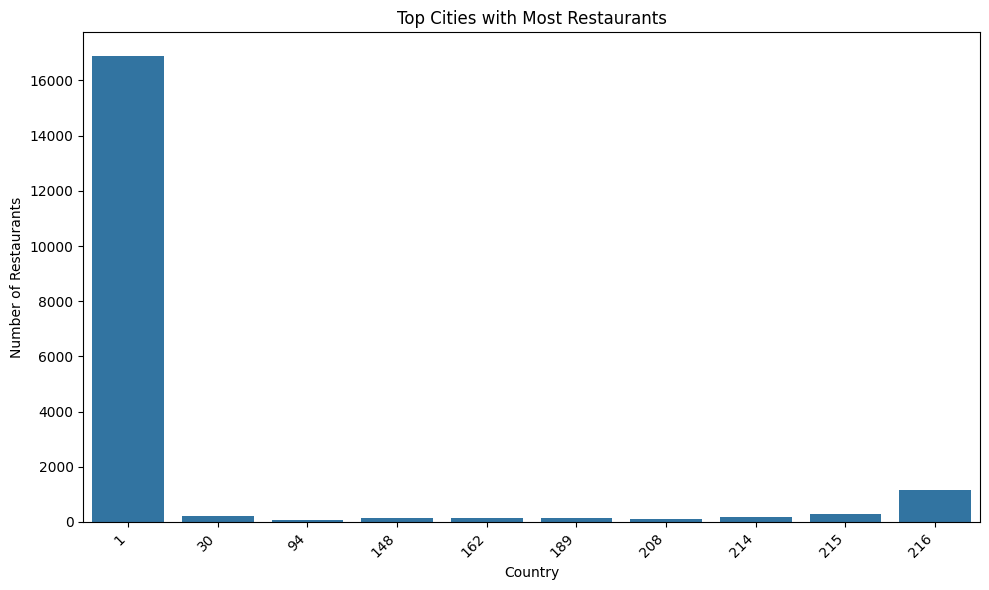

In [33]:
# Group by Country Code and count restaurants
country_counts = df.groupby('Country Code')['Restaurant ID'].count().sort_values(ascending=False)

# Display top countries
print("Top Countries with Most Restaurants:")
print(country_counts.head(10))

plt.figure(figsize=(10, 6))
sns.barplot(x=country_counts.head(10).index, y=country_counts.head(10).values)
plt.title('Top Cities with Most Restaurants')
plt.xlabel('Country')
plt.ylabel('Number of Restaurants')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

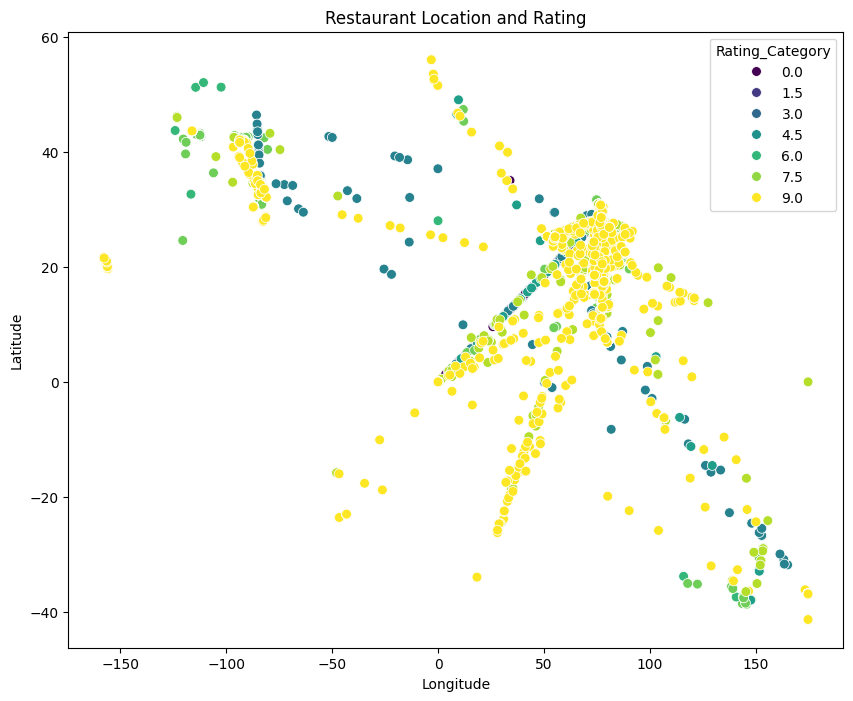

In [34]:
plt.figure(figsize=(10, 8))
sns.scatterplot(x='Longitude', y='Latitude', hue='Rating_Category', data=df, palette='viridis', s=50)
plt.title('Restaurant Location and Rating')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

#**LEVEL 2**

---



#Table Booking and online delivery

In [35]:
# Calculate table booking percentage
table_booking_count = df['Has Table booking'].sum()
table_booking_percentage = (table_booking_count / len(df)) * 100

# Calculate online delivery percentage
online_delivery_count = df['Has Online delivery'].sum()
online_delivery_percentage = (online_delivery_count / len(df)) * 100

# Print the results
print(f"Percentage of restaurants offering table booking: {table_booking_percentage:.2f}%")
print(f"Percentage of restaurants offering online delivery: {online_delivery_percentage:.2f}%")

Percentage of restaurants offering table booking: 15.33%
Percentage of restaurants offering online delivery: 34.06%


In [36]:
# Separate restaurants with and without table booking
restaurants_with_booking = df[df['Has Table booking'] == 1]
restaurants_without_booking = df[df['Has Table booking'] == 0]

# Calculate average ratings
avg_rating_with_booking = restaurants_with_booking['Rating_Category'].mean()
avg_rating_without_booking = restaurants_without_booking['Rating_Category'].mean()

# Print the results
print(f"Average rating of restaurants with table booking: {avg_rating_with_booking:.2f}")
print(f"Average rating of restaurants without table booking: {avg_rating_without_booking:.2f}")

# Compare the ratings
if avg_rating_with_booking > avg_rating_without_booking:
    print("Restaurants with table booking have a higher average rating.")
elif avg_rating_with_booking < avg_rating_without_booking:
    print("Restaurants without table booking have a higher average rating.")
else:
    print("Restaurants with and without table booking have the same average rating.")

Average rating of restaurants with table booking: 6.54
Average rating of restaurants without table booking: 5.20
Restaurants with table booking have a higher average rating.


Online Delivery Availability by Price Range:
Price range
1    8411
2    7358
3    3204
4     923
Name: Has Online delivery, dtype: int64


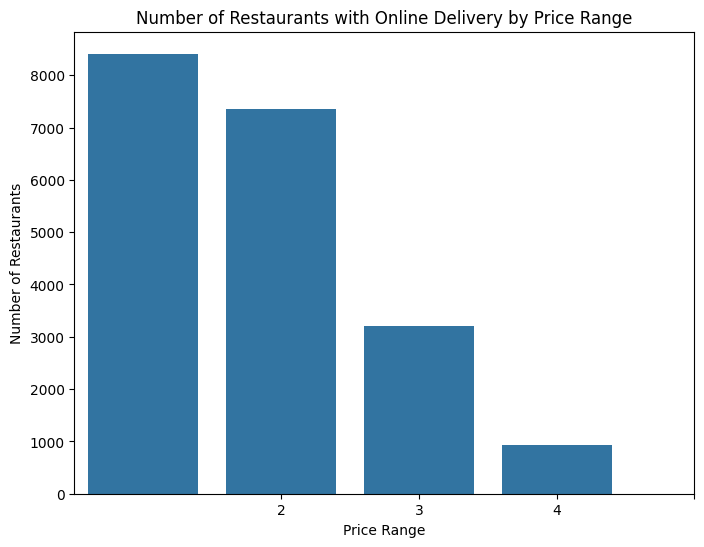

In [37]:
df['Price range'] = df['Price range'].astype(int)

# Group by price range and calculate online delivery availability
delivery_by_price_range = df.groupby('Price range')['Has Online delivery'].count()

# Print the results
print("Online Delivery Availability by Price Range:")
print(delivery_by_price_range)

# Create a bar plot for visualization
plt.figure(figsize=(8, 6))
sns.barplot(x=delivery_by_price_range.index, y=delivery_by_price_range.values)
plt.title('Number of Restaurants with Online Delivery by Price Range')
plt.xlabel('Price Range')
plt.ylabel('Number of Restaurants')
plt.xticks(delivery_by_price_range.index)
plt.show()

#Price Range Analysis

In [38]:
# Calculate the frequency of each price range
price_range_counts = df['Price range'].value_counts()

# Get the most common price range
most_common_price_range = price_range_counts.idxmax()

# Print the result
print(f"The most common price range is: {most_common_price_range}")

The most common price range is: 1


Average Rating by Price Range:
Price range
1    4.005588
2    5.360832
3    7.584270
4    7.603467
Name: Rating_Category, dtype: float64


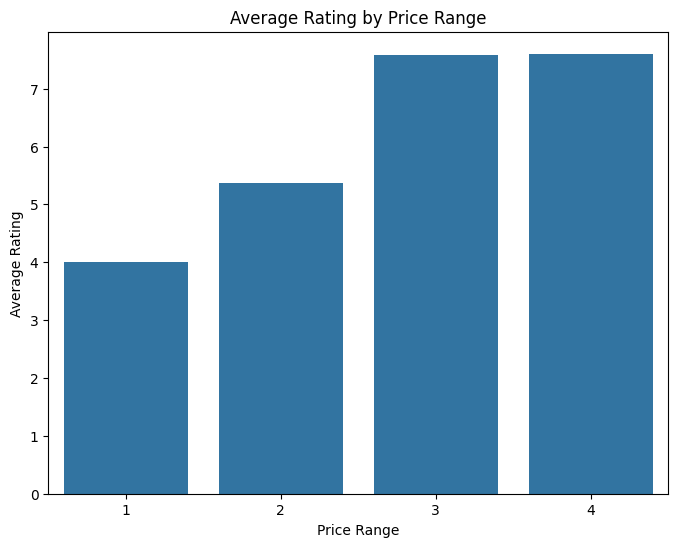

In [39]:
# Group by price range and calculate average rating
average_rating_by_price = df.groupby('Price range')['Rating_Category'].mean()

# Print the results
print("Average Rating by Price Range:")
print(average_rating_by_price)

# Visualize the results using a bar plot
plt.figure(figsize=(8, 6))
sns.barplot(x=average_rating_by_price.index, y=average_rating_by_price.values)
plt.title('Average Rating by Price Range')
plt.xlabel('Price Range')
plt.ylabel('Average Rating')
plt.show()

In [40]:
# Get the names of the one-hot encoded columns for rating color
rating_color_columns = [col for col in df.columns if col.startswith('Rating color_')]

# Calculate the average rating for each color
color_ratings = {}
for color_column in rating_color_columns:
    color = color_column.split('_')[1]
    average_rating = df[df[color_column] == 1]['Rating_Category'].mean()
    color_ratings[color] = average_rating

# Find the color with the highest average rating
highest_rated_color = max(color_ratings, key=color_ratings.get)

# Print the result
print(f"The color representing the highest average rating is: {highest_rated_color}")

The color representing the highest average rating is: Dark Green


#Feature Engineering

In [41]:
# Extract restaurant name length
df['Restaurant Name Length'] = df['Restaurant Name'].apply(len)

# Extract address length
df['Address Length'] = df['Address'].apply(len)

# Display the updated DataFrame
print(df.head())

   Restaurant ID         Restaurant Name  Country Code              City  \
0        6317637        Le Petit Souffle           162       Makati City   
1        6304287        Izakaya Kikufuji           162       Makati City   
2        6300002  Heat - Edsa Shangri-La           162  Mandaluyong City   
3        6318506                    Ooma           162  Mandaluyong City   
4        6314302             Sambo Kojin           162  Mandaluyong City   

                                             Address  \
0  Third Floor, Century City Mall, Kalayaan Avenu...   
1  Little Tokyo, 2277 Chino Roces Avenue, Legaspi...   
2  Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...   
3  Third Floor, Mega Fashion Hall, SM Megamall, O...   
4  Third Floor, Mega Atrium, SM Megamall, Ortigas...   

                                     Locality  \
0   Century City Mall, Poblacion, Makati City   
1  Little Tokyo, Legaspi Village, Makati City   
2  Edsa Shangri-La, Ortigas, Mandaluyong City   
3      SM 

<ipython-input-41-58408a7dc9b7>:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df['Restaurant Name Length'] = df['Restaurant Name'].apply(len)
<ipython-input-41-58408a7dc9b7>:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df['Address Length'] = df['Address'].apply(len)


#**Level 3**

#Predictive Modelling

In [42]:
print(df.head())

   Restaurant ID         Restaurant Name  Country Code              City  \
0        6317637        Le Petit Souffle           162       Makati City   
1        6304287        Izakaya Kikufuji           162       Makati City   
2        6300002  Heat - Edsa Shangri-La           162  Mandaluyong City   
3        6318506                    Ooma           162  Mandaluyong City   
4        6314302             Sambo Kojin           162  Mandaluyong City   

                                             Address  \
0  Third Floor, Century City Mall, Kalayaan Avenu...   
1  Little Tokyo, 2277 Chino Roces Avenue, Legaspi...   
2  Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...   
3  Third Floor, Mega Fashion Hall, SM Megamall, O...   
4  Third Floor, Mega Atrium, SM Megamall, Ortigas...   

                                     Locality  \
0   Century City Mall, Poblacion, Makati City   
1  Little Tokyo, Legaspi Village, Makati City   
2  Edsa Shangri-La, Ortigas, Mandaluyong City   
3      SM 

In [43]:
print(df.select_dtypes(include=['int64', 'float64']).columns.tolist())

['Restaurant ID', 'Country Code', 'Longitude', 'Latitude', 'Average Cost for two', 'Has Table booking', 'Has Online delivery', 'Is delivering now', 'Switch to order menu', 'Price range', 'Votes', 'Rating color_Dark Green', 'Rating color_Green', 'Rating color_Orange', 'Rating color_Red', 'Rating color_White', 'Rating color_Yellow', 'Rating text_Average', 'Rating text_Excellent', 'Rating text_Good', 'Rating text_Not rated', 'Rating text_Poor', 'Rating text_Very Good', 'Currency_Botswana Pula(P)', 'Currency_Brazilian Real(R$)', 'Currency_Dollar($)', 'Currency_Emirati Diram(AED)', 'Currency_Indian Rupees(Rs.)', 'Currency_Indonesian Rupiah(IDR)', 'Currency_NewZealand($)', 'Currency_Pounds(��)', 'Currency_Qatari Rial(QR)', 'Currency_Rand(R)', 'Currency_Sri Lankan Rupee(LKR)', 'Currency_Turkish Lira(TL)', 'Cuisine_ Afghani', 'Cuisine_ African', 'Cuisine_ American', 'Cuisine_ Andhra', 'Cuisine_ Arabian', 'Cuisine_ Argentine', 'Cuisine_ Armenian', 'Cuisine_ Asian', 'Cuisine_ Assamese', 'Cuisine

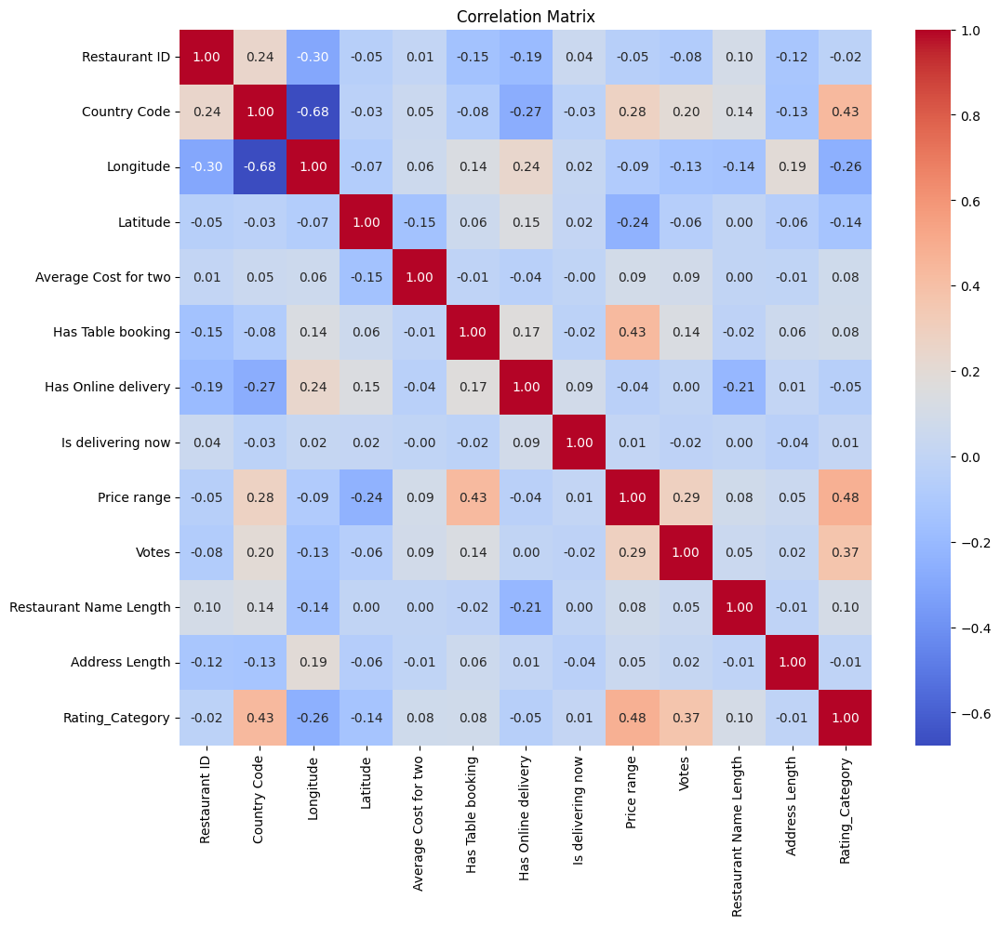

In [44]:
# Select the numerical features for correlation analysis
numerical_features = ['Restaurant ID', 'Country Code', 'Longitude', 'Latitude', 'Average Cost for two', 'Has Table booking',
                      'Has Online delivery', 'Is delivering now', 'Price range', 'Votes', 'Restaurant Name Length',
                      'Address Length', 'Rating_Category']

# Calculate the correlation matrix
correlation_matrix = df[numerical_features].corr()

# Create a heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix')
plt.show()

In [45]:
# Select features and target variable
features = ['Country Code', 'Longitude', 'Latitude', 'Average Cost for two', 'Price range', 'Votes',
            'Has Table booking', 'Has Online delivery', 'Is delivering now', 'Switch to order menu']

# Add cuisine columns
features.extend([col for col in df.columns if col.startswith('Cuisine_')])

# Target variable
target = 'Rating_Category'

# Split data
X = df[features]
y = df[target]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Build and Evaluate Models:
models = {
    'Linear Regression': LinearRegression(),
    'Decision Tree': DecisionTreeRegressor(random_state=42),
    'Random Forest': RandomForestRegressor(random_state=42)
}

for model_name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    print(f"{model_name}:")
    print(f"  Mean Squared Error: {mse:.2f}")
    print(f"  R-squared: {r2:.2f}")
    print("-" * 30)

Linear Regression:
  Mean Squared Error: 356578701400.95
  R-squared: -48994790310.50
------------------------------
Decision Tree:
  Mean Squared Error: 0.70
  R-squared: 0.90
------------------------------
Random Forest:
  Mean Squared Error: 0.35
  R-squared: 0.95
------------------------------


#Customer Prefrence Analysis

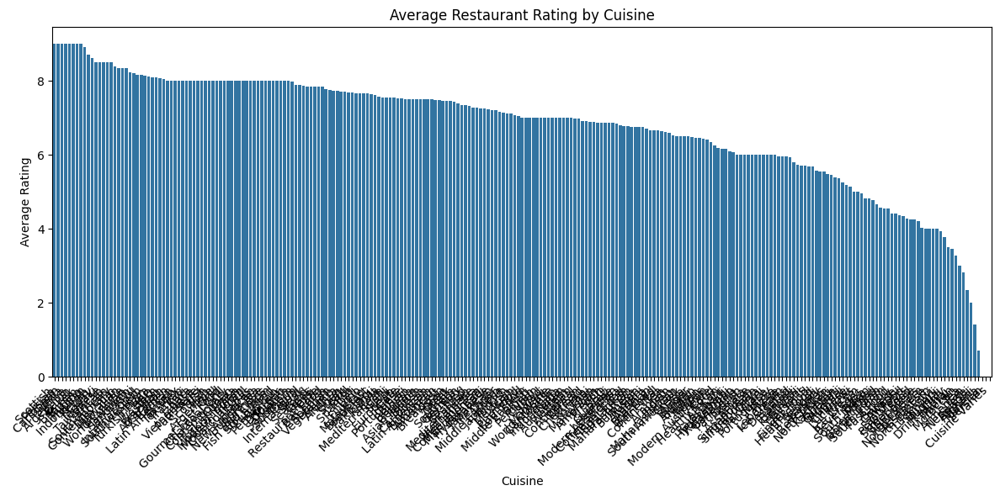

In [46]:
# Calculate average rating for each cuisine:
cuisine_ratings = {}
cuisine_cols = [col for col in df.columns if col.startswith('Cuisine_')]
for cuisine_col in cuisine_cols:
    cuisine_name = cuisine_col.replace('Cuisine_', '')
    avg_rating = df[df[cuisine_col] == 1]['Rating_Category'].mean()
    cuisine_ratings[cuisine_name] = avg_rating

# Create a DataFrame for visualization:
cuisine_ratings_df = pd.DataFrame.from_dict(cuisine_ratings, orient='index', columns=['Average Rating'])
cuisine_ratings_df.sort_values(by=['Average Rating'], ascending=False, inplace=True)

# Visualize using a bar plot:
plt.figure(figsize=(12, 6))
sns.barplot(x=cuisine_ratings_df.index, y=cuisine_ratings_df['Average Rating'])
plt.title('Average Restaurant Rating by Cuisine')
plt.xlabel('Cuisine')
plt.ylabel('Average Rating')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

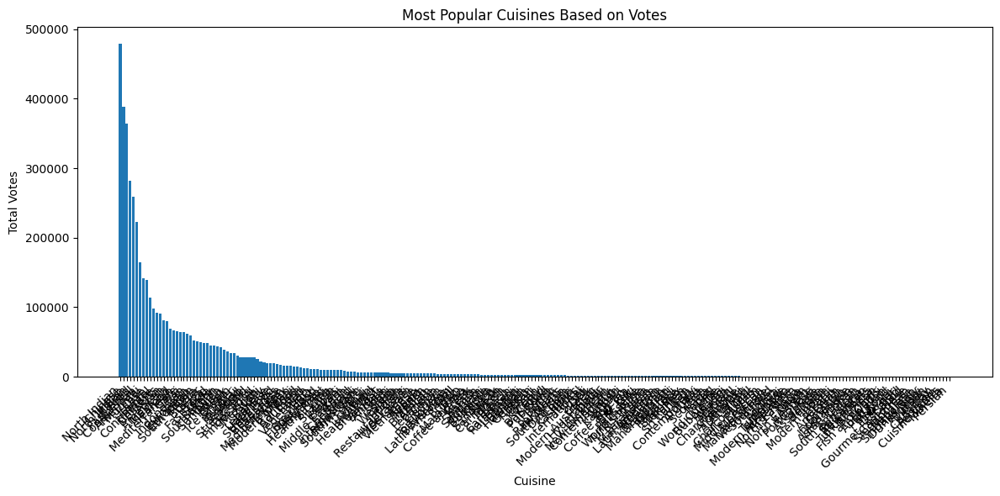

Top 10 Most Popular Cuisines:
               Total Votes
North Indian        478913
 Chinese            388723
 North Indian       364735
 Italian            281736
 Fast Food          259402
 Continental        222713
American            165090
 Mughlai            141200
Cafe                138644
Italian             113577


In [47]:
# Calculate total votes for each cuisine:
cuisine_votes = {}
cuisine_cols = [col for col in df.columns if col.startswith('Cuisine_')]
for cuisine_col in cuisine_cols:
    cuisine_name = cuisine_col.replace('Cuisine_', '')
    total_votes = df[df[cuisine_col] == 1]['Votes'].sum()  # Sum votes for restaurants with the cuisine
    cuisine_votes[cuisine_name] = total_votes

# Create a DataFrame for visualization:
cuisine_votes_df = pd.DataFrame.from_dict(cuisine_votes, orient='index', columns=['Total Votes'])
cuisine_votes_df.sort_values(by=['Total Votes'], ascending=False, inplace=True)

# Visualize using a bar plot:
plt.figure(figsize=(12, 6))
plt.bar(cuisine_votes_df.index, cuisine_votes_df['Total Votes'])
plt.title('Most Popular Cuisines Based on Votes')
plt.xlabel('Cuisine')
plt.ylabel('Total Votes')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for readability
plt.tight_layout()
plt.show()

# Print the top N most popular cuisines:
top_n = 10
print(f"Top {top_n} Most Popular Cuisines:")
print(cuisine_votes_df.head(top_n))

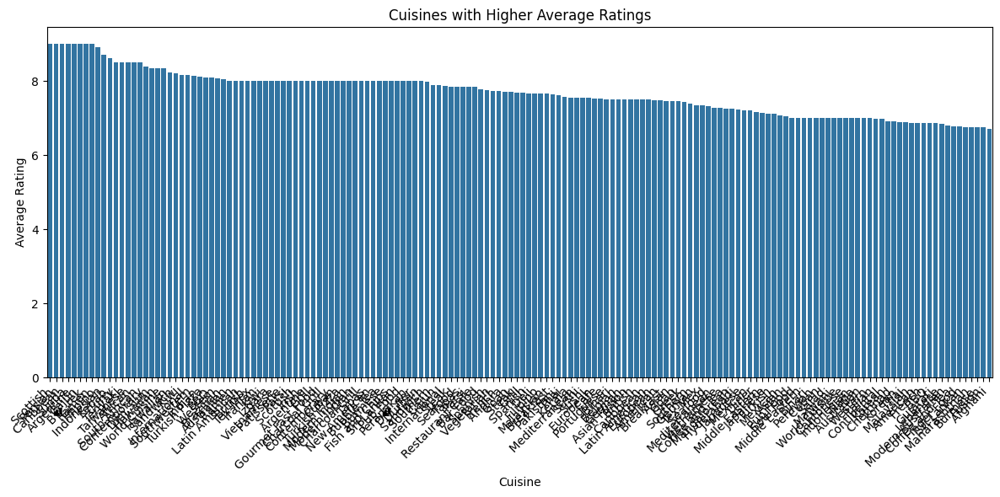

Cuisines with Higher Average Ratings:
                Average Rating
Scottish              9.000000
Persian               9.000000
 Caribbean            9.000000
Sunda                 9.000000
Argentine             9.000000
...                        ...
 Sri Lankan           6.750000
 Maharashtrian        6.750000
Burmese               6.750000
 Fusion               6.750000
 Afghani              6.714286

[158 rows x 1 columns]


In [48]:
# Identify cuisines with higher ratings:
higher_rating_threshold = cuisine_ratings_df['Average Rating'].mean()  # Using overall average as threshold
high_rated_cuisines = cuisine_ratings_df[cuisine_ratings_df['Average Rating'] > higher_rating_threshold]

# Visualize:
plt.figure(figsize=(12, 6))
sns.barplot(x=high_rated_cuisines.index, y=high_rated_cuisines['Average Rating'])
plt.title('Cuisines with Higher Average Ratings')
plt.xlabel('Cuisine')
plt.ylabel('Average Rating')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# Print the cuisines with higher ratings:
print("Cuisines with Higher Average Ratings:")
print(high_rated_cuisines)